### Laboratorium 6 - część badawcza

W pakiecie OpenCV wszystkie zadania związane z detekcją i opisem punktów kluczowych realizowane są przez zestaw specjalnych klas, dla których bazową jest `cv::Feature2D`. Jedną z wielu pochodnych tej klasy jest interesująca nas na zajęciach `cv::SIFT`, z której dokumentacją należy się zapoznać.  
Najważniejsze, co trzeba wiedzieć:
1. do konstrukcji obiektu SIFT służy metoda [`cv2.SIFT_create`](https://docs.opencv.org/4.x/d7/d60/classcv_1_1SIFT.html#ad337517bfdc068ae0ba0924ff1661131) - to do niej przekazujemy parametry detektora (w dokumentacji występuje jako `cv::SIFT::create`);
2. obsługujemy detektor przez interfejs `cv::Feature2D`, konkretnie metody [`detect`](https://docs.opencv.org/4.x/d0/d13/classcv_1_1Feature2D.html#aa4e9a7082ec61ebc108806704fbd7887) do detekcji punktów kluczowych oraz [`compute`](https://docs.opencv.org/4.x/d0/d13/classcv_1_1Feature2D.html#ab3cce8d56f4fc5e1d530b5931e1e8dc0) do obliczania ich deskryptorów (opcjonalnie `detectAndCompute`).

Schemat użycia:
```python
sift_instance = cv2.SIFT_create()
# 'image' powinno być obrazem jednokanałowym (jeśli nie, zostanie zastosowane cvtColor z flagą COLOR_BGR2GRAY)
keypoints = sift_instance.detect(image)
keypoints, descriptors = sift_instance.compute(image, keypoints)
```

`keypoints` jest listą obiektów specjalnego typu `cv2.KeyPoint`, która **jest modyfikowana** przez `SIFT::compute`!  
`descriptors` jest natomiast macierzą float32 o wymiarach NxK, gdzie N jest liczbą punktów kluczowych, a K jest liczbą obliczonych cech.

Warto również zapoznać się z funkcją [`cv2.drawKeypoints`](https://docs.opencv.org/4.x/d4/d5d/group__features2d__draw.html#ga5d2bafe8c1c45289bc3403a40fb88920) w kontekście prezentacji wyników. Zwróć uwagę na flagi sterujące rysowaniem - szczególnie użyteczna jest `cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS`.

In [2]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

#### Zadanie 1

Przetestuj wpływ podstawowych parametrów detektora SIFT (`contrastThreshold` i `edgeThreshold`) na uzyskiwane punkty kluczowe (liczność, lokalizacja, rozmiar), korzystając z obrazów `cells` i `lena`. Pamiętaj że ich działanie jest odwrotne (tzn. jeden odsiewa cechy "mniejsze niż", a drugi "większe niż").

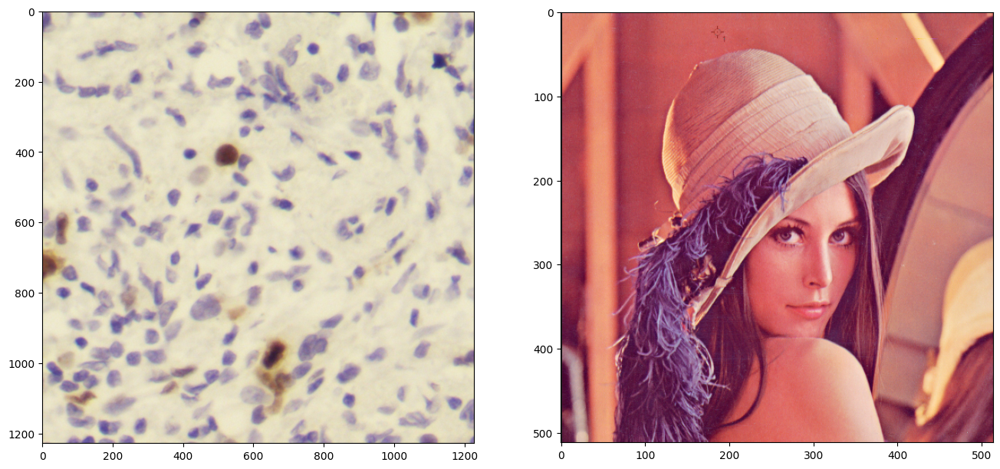

In [3]:
cells = cv2.imread("p1_0308_7.jpg")
lena = cv2.imread("Lena.jpg")
f, (a1, a2) = plt.subplots(1, 2, figsize=(16, 10))
a1.imshow(cells[..., ::-1])
a2.imshow(lena[..., ::-1])

In [4]:
from ipywidgets import interact, FloatSlider


def get_kps(img, *args, **kwargs):
    sift = cv2.SIFT_create(*args, **kwargs)
    kps, _ = sift.detectAndCompute(img, mask=None)
    return kps


@interact(contrastThreshold=FloatSlider(min=0, max=0.3, step=0.001, value=0.04))
def play_with_contrastThreshold(contrastThreshold):
    kps = get_kps(lena, contrastThreshold=contrastThreshold)
    kps_cells = get_kps(cells, contrastThreshold=contrastThreshold)
    f, (a1, a2) = plt.subplots(1, 2, figsize=(12, 12))
    d_lena = cv2.drawKeypoints(
        lena, kps_cells, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS
    )
    d_query = cv2.drawKeypoints(
        cells, kps_cells, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS
    )
    mean_kp_size = np.mean([kp.size for kp in kps]) if kps else 0
    mean_kp_size_cells = np.mean([kp.size for kp in kps_cells]) if kps_cells else 0
    a1.imshow(d_lena[..., ::-1])
    a1.set_title("A ({} punktów) ($\mu$={:.2f})".format(len(kps), mean_kp_size))
    a2.imshow(d_query[..., ::-1])
    a2.set_title(
        "B ({} punktów) ($\mu$={:.2f})".format(len(kps_cells), mean_kp_size_cells)
    )

interactive(children=(FloatSlider(value=0.04, description='contrastThreshold', max=0.3, step=0.001), Output())…

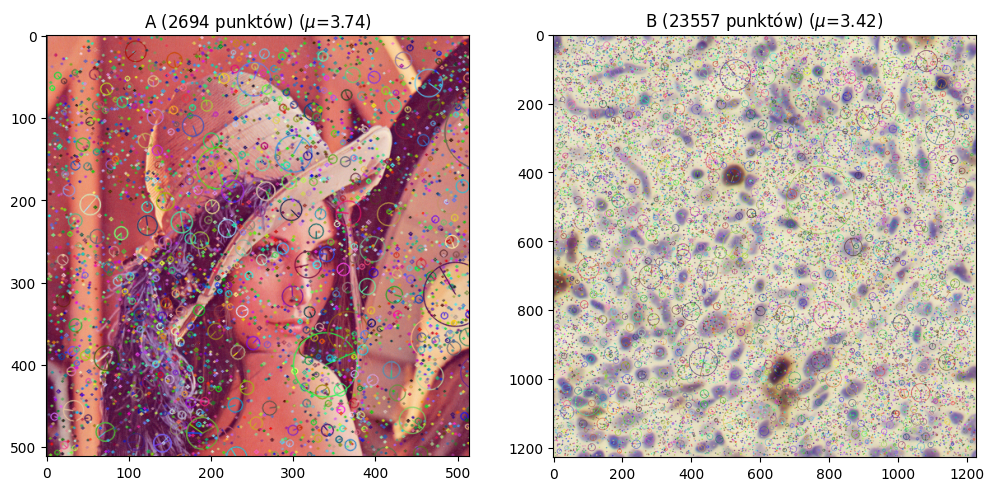

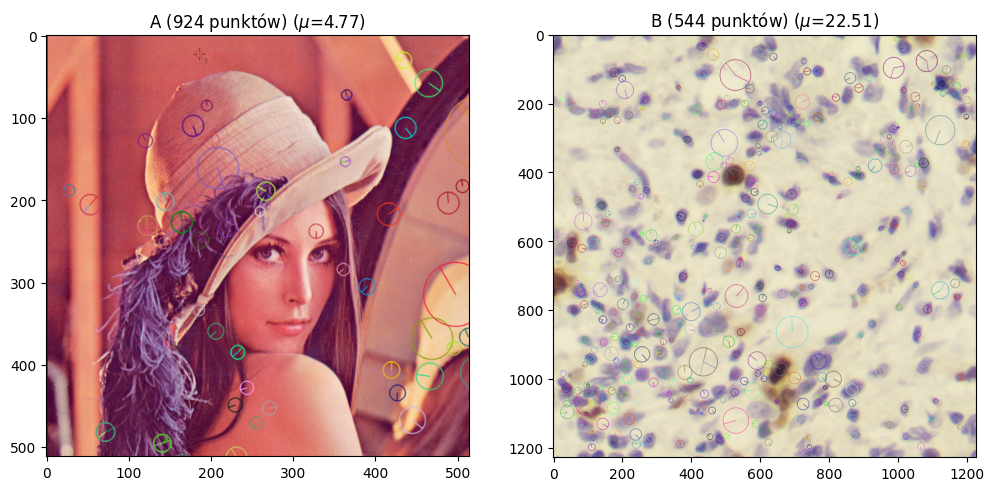

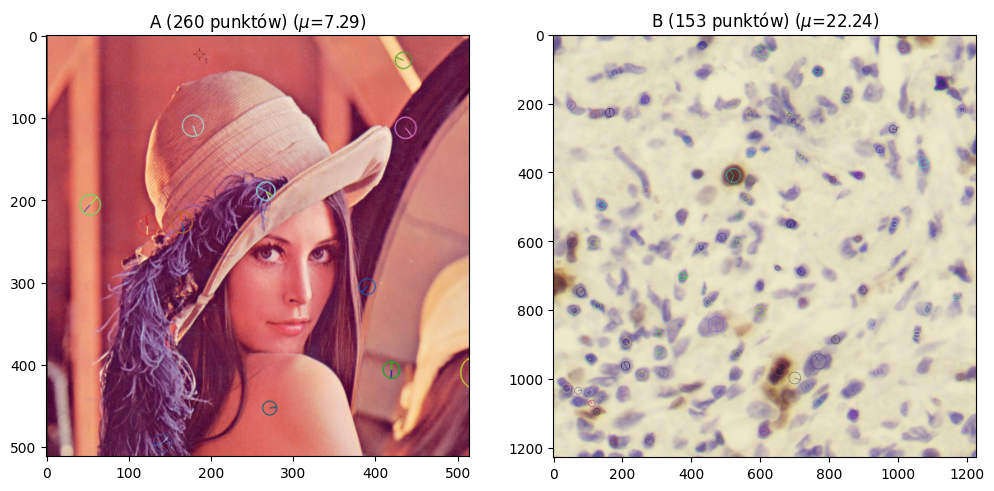

In [5]:
play_with_contrastThreshold(0.00)
# generally, Lena has fewer keypoints than cells, at lowest threshold
play_with_contrastThreshold(0.05)
play_with_contrastThreshold(0.1)
# as contrast threshold rises, Lena has more keypoints than cells
# maybe because it has more local contrast than cells

/tmp/ipykernel_65399/2841270182.py:38: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


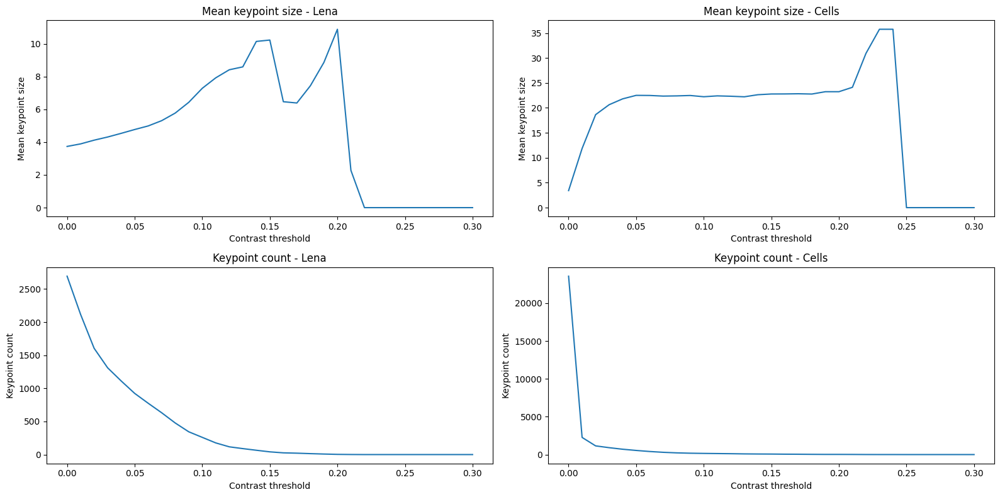

In [6]:
# generally larger contrast threshold means larger mean keypoint size (as a general trend with potential outliers)

searched_range = np.arange(0.00, 0.31, 0.01)

datapoints_mean_kp_size = []
datapoints_kp_count = []

for i in searched_range:
    kps = get_kps(lena, contrastThreshold=i)
    cells_kps = get_kps(cells, contrastThreshold=i)
    mean_lena_kps_size = np.mean([kp.size for kp in kps]) if kps else 0
    mean_cells_kps_size = np.mean([kp.size for kp in cells_kps]) if cells_kps else 0
    datapoints_mean_kp_size.append((mean_lena_kps_size, mean_cells_kps_size))

    datapoints_kp_count.append((len(kps), len(cells_kps)))

fig, ax = plt.subplots(ncols=2, nrows=2, figsize=(16, 8))
ax = ax.flatten()
ax[0].plot(searched_range, [x[0] for x in datapoints_mean_kp_size], label="Lena")
ax[0].set_title("Mean keypoint size - Lena")
ax[0].set_xlabel("Contrast threshold")
ax[0].set_ylabel("Mean keypoint size")
ax[1].plot(searched_range, [x[1] for x in datapoints_mean_kp_size], label="Cells")
ax[1].set_title("Mean keypoint size - Cells")
ax[1].set_xlabel("Contrast threshold")
ax[1].set_ylabel("Mean keypoint size")

ax[2].plot(searched_range, [x[0] for x in datapoints_kp_count], label="Lena")
ax[2].set_title("Keypoint count - Lena")
ax[2].set_xlabel("Contrast threshold")
ax[2].set_ylabel("Keypoint count")
ax[3].plot(searched_range, [x[1] for x in datapoints_kp_count], label="Cells")
ax[3].set_title("Keypoint count - Cells")
ax[3].set_xlabel("Contrast threshold")
ax[3].set_ylabel("Keypoint count")

fig.tight_layout()
fig.show()

In [7]:
@interact(edgeThreshold=FloatSlider(min=0, max=0.5, step=0.001, value=0.29))
def play_with_edgeThreshold(edgeThreshold):
    kps = get_kps(lena, edgeThreshold=edgeThreshold)
    kps_cells = get_kps(cells, edgeThreshold=edgeThreshold)
    f, (a1, a2) = plt.subplots(1, 2, figsize=(12, 12))
    d_lena = cv2.drawKeypoints(
        lena, kps_cells, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS
    )
    d_query = cv2.drawKeypoints(
        cells, kps_cells, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS
    )
    a1.imshow(d_lena[..., ::-1])
    a1.set_title("A ({} punktów)".format(len(kps)))
    a2.imshow(d_query[..., ::-1])
    a2.set_title("B ({} punktów)".format(len(kps_cells)))

interactive(children=(FloatSlider(value=0.29, description='edgeThreshold', max=0.5, step=0.001), Output()), _d…

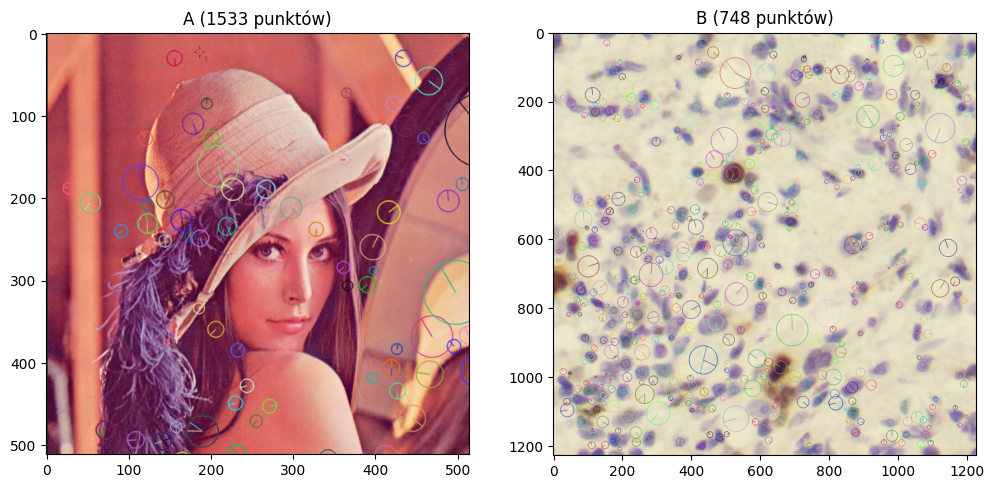

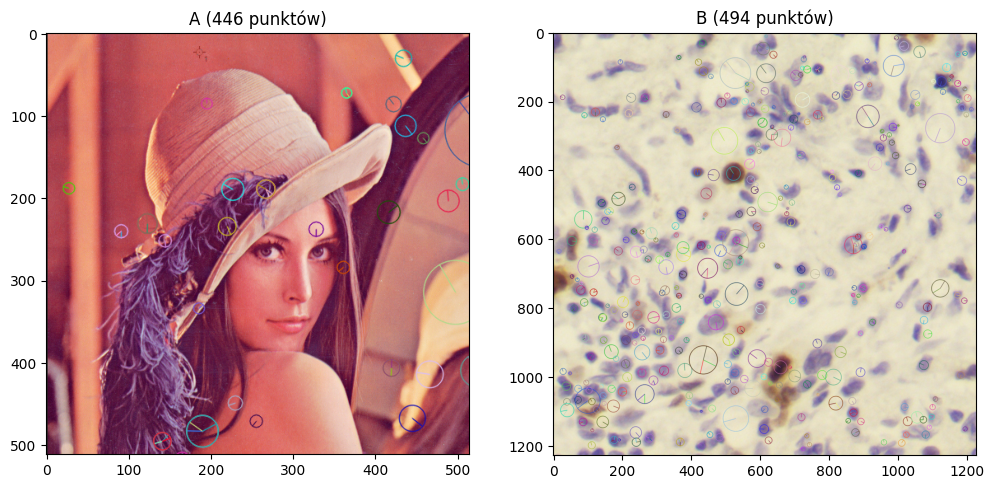

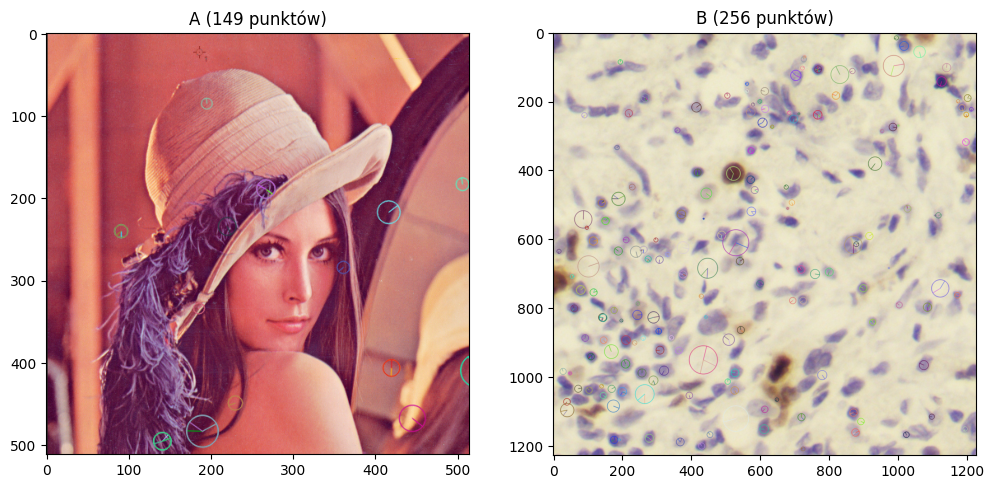

In [8]:
play_with_edgeThreshold(0.0)
# generally, Lena has more keypoints than cells, at lowest threshold
# edgethreshold is more restrictive, because it filters out edge-like features
play_with_edgeThreshold(0.29)
play_with_edgeThreshold(0.5)

/tmp/ipykernel_65399/2958488068.py:38: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


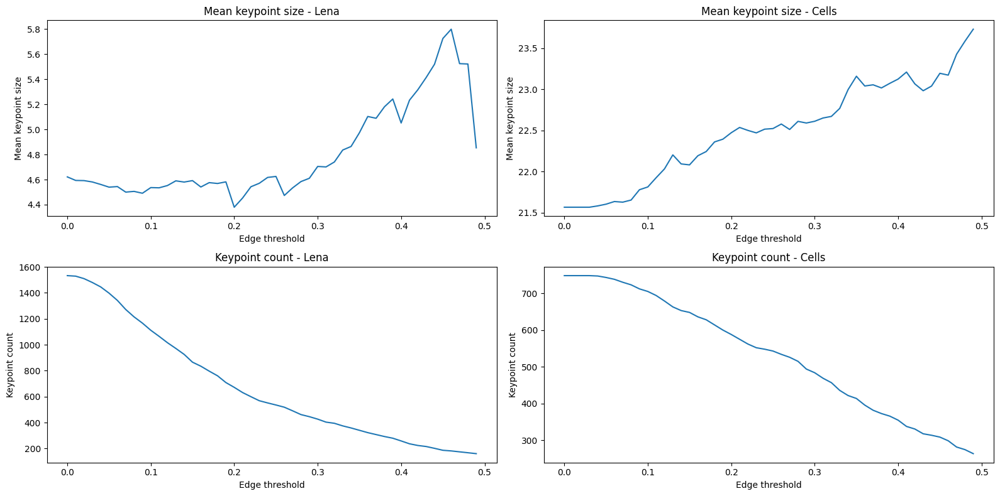

In [9]:
# generally larger edge threshold means larger mean keypoint size (as a general trend with potential outliers)

searched_range = np.arange(0.00, 0.5, 0.01)

datapoints_mean_kp_size = []
datapoints_kp_count = []

for i in searched_range:
    kps = get_kps(lena, edgeThreshold=i)
    cells_kps = get_kps(cells, edgeThreshold=i)
    mean_lena_kps_size = np.mean([kp.size for kp in kps]) if kps else 0
    mean_cells_kps_size = np.mean([kp.size for kp in cells_kps]) if cells_kps else 0
    datapoints_mean_kp_size.append((mean_lena_kps_size, mean_cells_kps_size))

    datapoints_kp_count.append((len(kps), len(cells_kps)))

fig, ax = plt.subplots(ncols=2, nrows=2, figsize=(16, 8))
ax = ax.flatten()
ax[0].plot(searched_range, [x[0] for x in datapoints_mean_kp_size], label="Lena")
ax[0].set_title("Mean keypoint size - Lena")
ax[0].set_xlabel("Edge threshold")
ax[0].set_ylabel("Mean keypoint size")
ax[1].plot(searched_range, [x[1] for x in datapoints_mean_kp_size], label="Cells")
ax[1].set_title("Mean keypoint size - Cells")
ax[1].set_xlabel("Edge threshold")
ax[1].set_ylabel("Mean keypoint size")

ax[2].plot(searched_range, [x[0] for x in datapoints_kp_count], label="Lena")
ax[2].set_title("Keypoint count - Lena")
ax[2].set_xlabel("Edge threshold")
ax[2].set_ylabel("Keypoint count")
ax[3].plot(searched_range, [x[1] for x in datapoints_kp_count], label="Cells")
ax[3].set_title("Keypoint count - Cells")
ax[3].set_xlabel("Edge threshold")
ax[3].set_ylabel("Keypoint count")

fig.tight_layout()
fig.show()

In [10]:
@interact(
    contrastThreshold=FloatSlider(min=0, max=0.3, step=0.001, value=0.04),
    edgeThreshold=FloatSlider(min=0, max=0.5, step=0.001, value=0.29),
)
def play_with_both(contrastThreshold, edgeThreshold):
    kps = get_kps(
        lena, contrastThreshold=contrastThreshold, edgeThreshold=edgeThreshold
    )
    kps_cells = get_kps(
        cells, contrastThreshold=contrastThreshold, edgeThreshold=edgeThreshold
    )
    f, (a1, a2) = plt.subplots(1, 2, figsize=(12, 12))
    d_lena = cv2.drawKeypoints(
        lena, kps_cells, None, flags=cv2.DRAW_MATCHES_FLAGS_DEFAULT, color=(255, 0, 255)
    )
    d_query = cv2.drawKeypoints(
        cells,
        kps_cells,
        None,
        flags=cv2.DRAW_MATCHES_FLAGS_DEFAULT,
        color=(255, 0, 255),
    )
    mean_kp_size = np.mean([kp.size for kp in kps]) if kps else 0
    mean_kp_size_cells = np.mean([kp.size for kp in kps_cells]) if kps_cells else 0
    a1.imshow(d_lena[..., ::-1])
    a1.set_title("A ({} punktów) ($\mu$={:.2f})".format(len(kps), mean_kp_size))
    a2.imshow(d_query[..., ::-1])
    a2.set_title(
        "B ({} punktów) ($\mu$={:.2f})".format(len(kps_cells), mean_kp_size_cells)
    )

interactive(children=(FloatSlider(value=0.04, description='contrastThreshold', max=0.3, step=0.001), FloatSlid…

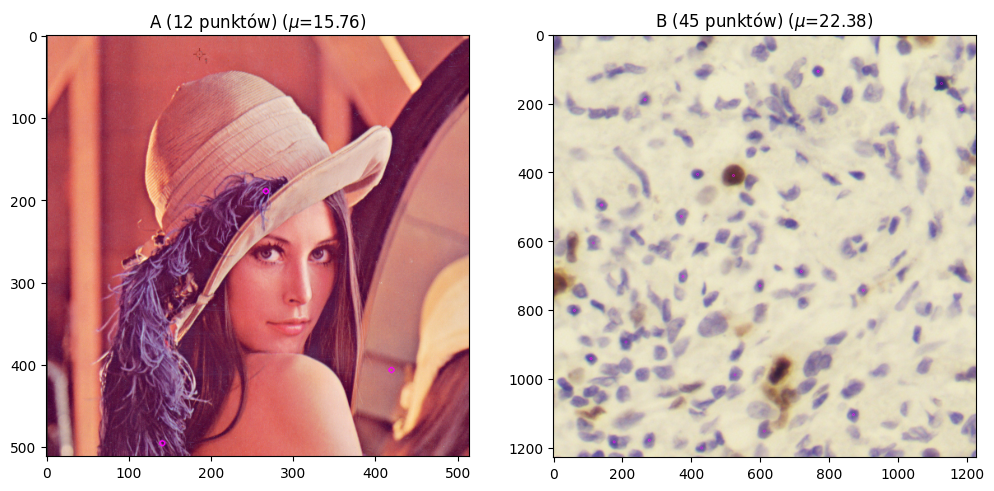

In [11]:
play_with_both(contrastThreshold=0.15, edgeThreshold=0.5)

#### Zadanie 2

Detektor SIFT jest w teorii niezmienniczy względem translacji, rotacji czy zmiany skali. Przetestuj te własności w praktyce, sprawdzając stabilność punktów wykrywanych na obróconej i przeskalowanej wersji obrazów `cells` i `lena`. Dokonaj oceny wizualnie, sprawdzając zachowanie detektora dla kilku wybranych rotacji i skal (**nie** grid search).

_Co świadczy o stabilności i niezmienniczości detektora?_

1. Niewrażliwość na skalę - gwarantowana przez analizę obrazu w różnej skali (oktawy)
2. Niewrażliwość na translację - przesunięcie pikseli powoduje przesunięcie lokalnego maksimum w DoG
3. Niewrażliwość na rotację - obrót obrazu domyślnie powoduje też obrót wszystkich skierowań gradientów (niefajnie), dlatego orientacje z każdego pod-bloku wokół punktu kluczowego są pomniejszane o orientację (obrót) całego punktu kluczowego

In [12]:
def rotate(image, angle, scale=1.0):
    center = (image.shape[0] // 2, image.shape[1] // 2)
    rmat = cv2.getRotationMatrix2D(center, angle, scale)
    return cv2.warpAffine(
        image, rmat, (image.shape[0], image.shape[1]), flags=cv2.INTER_CUBIC
    )

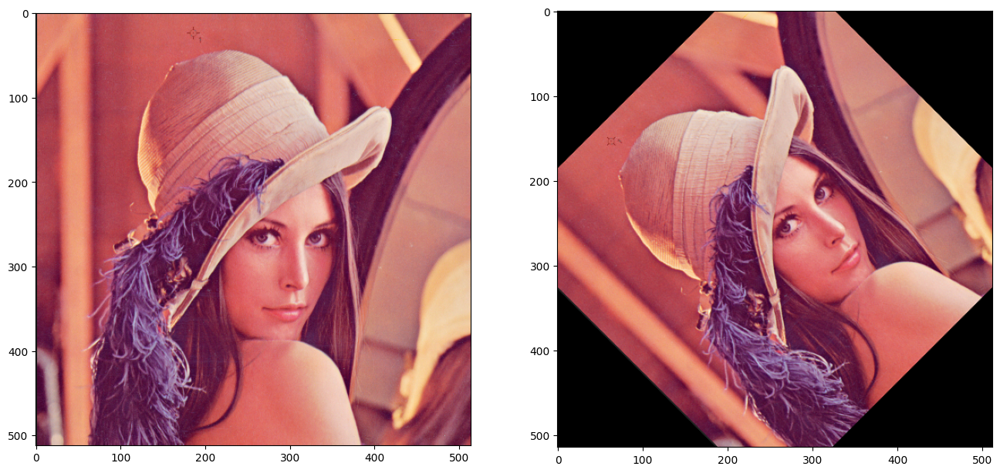

In [13]:
# przykład dla Leny, pamiętaj o cells!
lena_rot = rotate(lena, 45.0, scale=0.9)
f, (a1, a2) = plt.subplots(1, 2, figsize=(16, 10))
a1.imshow(lena[..., ::-1])
a2.imshow(lena_rot[..., ::-1])

Text(0.5, 1.0, 'Oryginał, 1112 punktów')

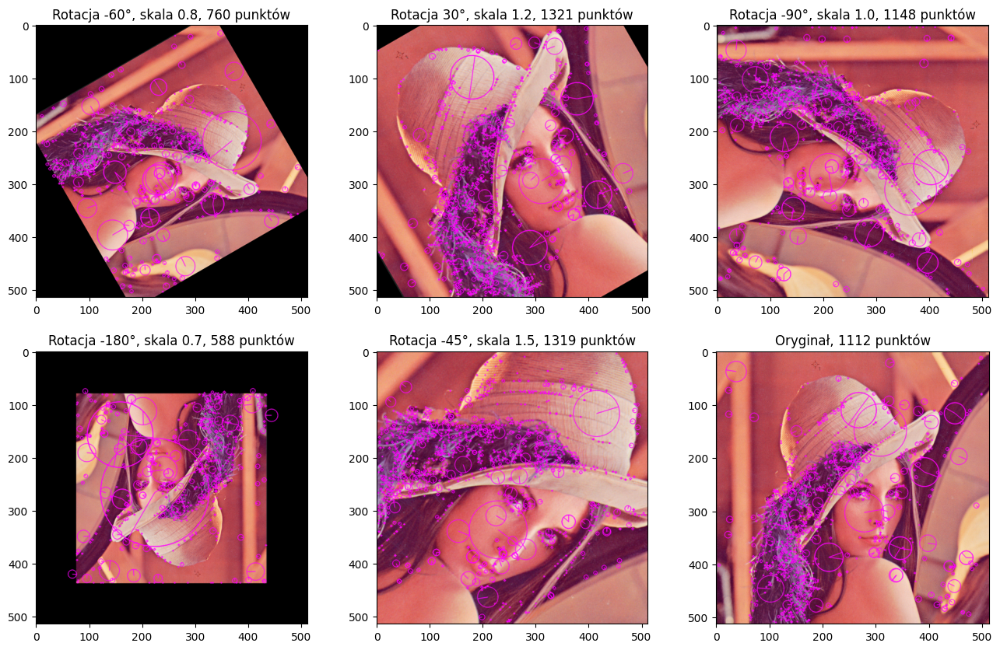

In [14]:
modifiers = [(-60, 0.8), (30, 1.2), (-90, 1.0), (-180, 0.7), (-45, 1.5)]

f, axs = plt.subplots(2, 3, figsize=(16, 10))
axs = axs.flatten()

for i, (angle, scale) in enumerate(modifiers):
    lena_rot = rotate(lena, angle, scale=scale)
    kps = get_kps(lena_rot)
    d_lena = cv2.drawKeypoints(
        lena_rot,
        kps,
        None,
        flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS,
        color=(255, 0, 255),
    )
    axs[i].imshow(d_lena[..., ::-1])
    axs[i].set_title("Rotacja {}°, skala {}, {} punktów".format(angle, scale, len(kps)))

kps = get_kps(lena)
d_lena = cv2.drawKeypoints(
    lena,
    kps,
    None,
    flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS,
    color=(255, 0, 255),
)
axs[-1].imshow(d_lena[..., ::-1])
axs[-1].set_title("Oryginał, {} punktów".format(len(kps)))

Text(0.5, 1.0, 'Oryginał, 705 punktów')

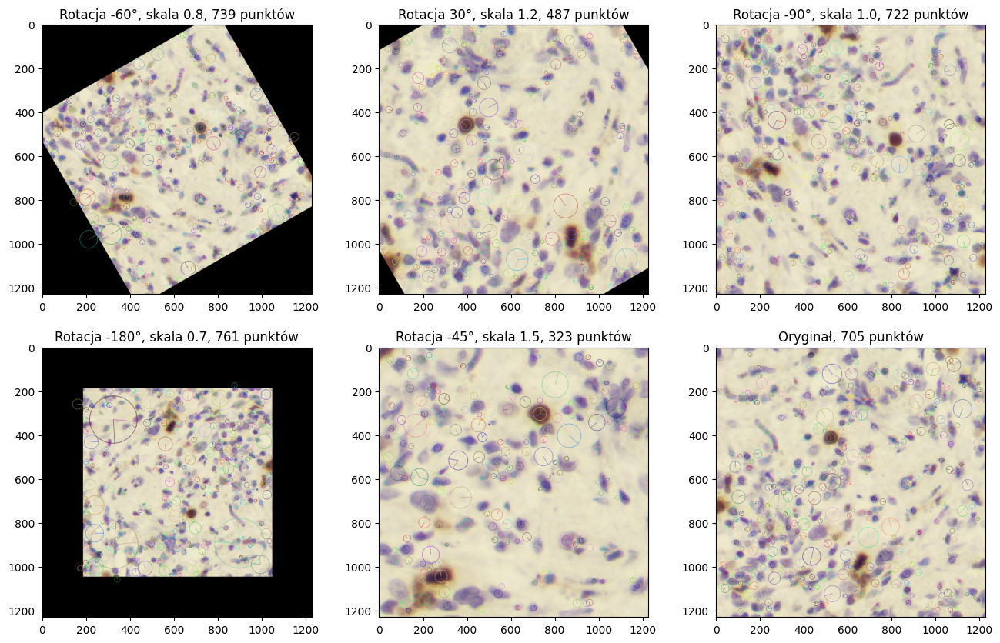

In [15]:
modifiers = [(-60, 0.8), (30, 1.2), (-90, 1.0), (-180, 0.7), (-45, 1.5)]

f, axs = plt.subplots(2, 3, figsize=(16, 10))
axs = axs.flatten()

for i, (angle, scale) in enumerate(modifiers):
    cells_rot = rotate(cells, angle, scale=scale)
    kps = get_kps(cells_rot)
    d_cells = cv2.drawKeypoints(
        cells_rot, kps, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS
    )
    axs[i].imshow(d_cells[..., ::-1])
    axs[i].set_title("Rotacja {}°, skala {}, {} punktów".format(angle, scale, len(kps)))

kps = get_kps(cells)
d_cells = cv2.drawKeypoints(
    cells, kps, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS
)
axs[-1].imshow(d_cells[..., ::-1])
axs[-1].set_title("Oryginał, {} punktów".format(len(kps)))

#### Zadanie 3

Dane są obrazy `coke` i `table`. Wykorzystaj metodologię parowania punktów kluczowych do znalezienia wystąpienia puszki z Colą na stole. To zadanie jest podzielone na dwie części - czytaj dalej.

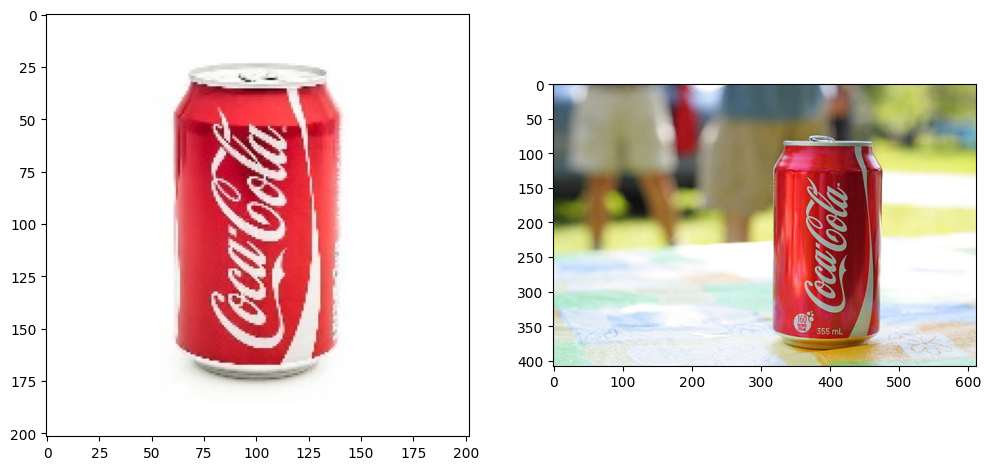

In [16]:
coke = cv2.imread("coke.jpg")
table = cv2.imread("coke-table.jpg")
f, (a1, a2) = plt.subplots(1, 2, figsize=(12, 12))
a1.imshow(coke[..., ::-1])
a2.imshow(table[..., ::-1])

##### Zadanie 3a

Wykonaj detekcję punktów kluczowych i ich parowanie z użyciem dowolnego matchera. Wykonaj filtrację znalezionych par po dystansie - co obserwujesz, zmieniając próg?

In [17]:
from ipywidgets import IntSlider


def get_matches(contrastThreshold):
    matcher = cv2.BFMatcher_create()
    sift = cv2.SIFT_create(contrastThreshold=contrastThreshold)
    kp1, ds1 = sift.detectAndCompute(coke, mask=None)
    kp2, ds2 = sift.detectAndCompute(table, mask=None)
    best_matches = (
        matcher.match(ds1, ds2) if ds1 is not None and ds2 is not None else None
    )
    return best_matches, kp1, ds1, kp2, ds2


@interact(distance_threshold=IntSlider(min=0, max=500, step=1, value=50))
def play_with_distance_threshold(distance_threshold):
    best_matches, kp1, ds1, kp2, ds2 = get_matches(contrastThreshold=0.05)
    good_matches = [m for m in best_matches if m.distance < distance_threshold]

    show_matches = cv2.drawMatches(
        coke,
        kp1,
        table,
        kp2,
        good_matches,
        None,
        matchColor=(0, 255, 0),
        singlePointColor=(0, 0, 255),
    )
    plt.subplots(1, 1, figsize=(12, 12))[1].imshow(show_matches[..., ::-1])
    plt.title("Distance threshold: {}".format(distance_threshold))

interactive(children=(IntSlider(value=50, description='distance_threshold', max=500), Output()), _dom_classes=…

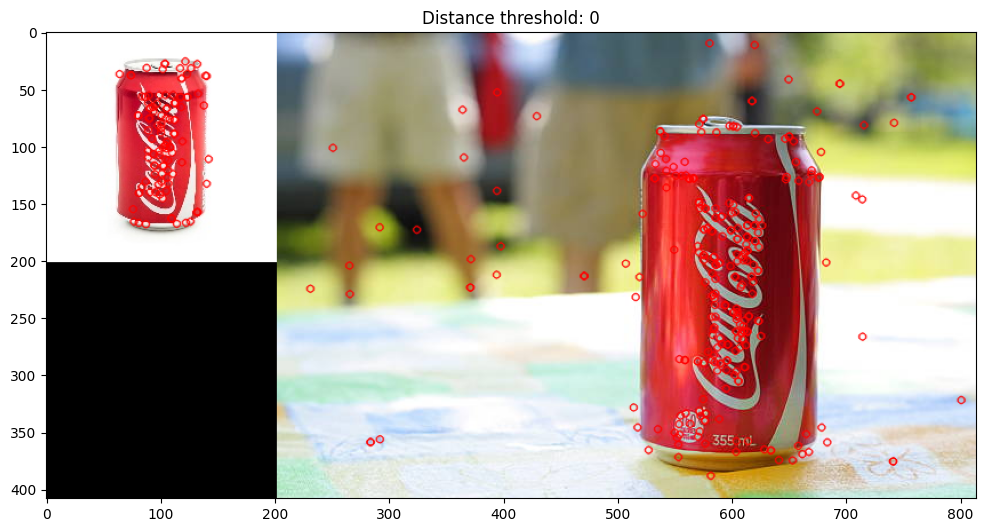

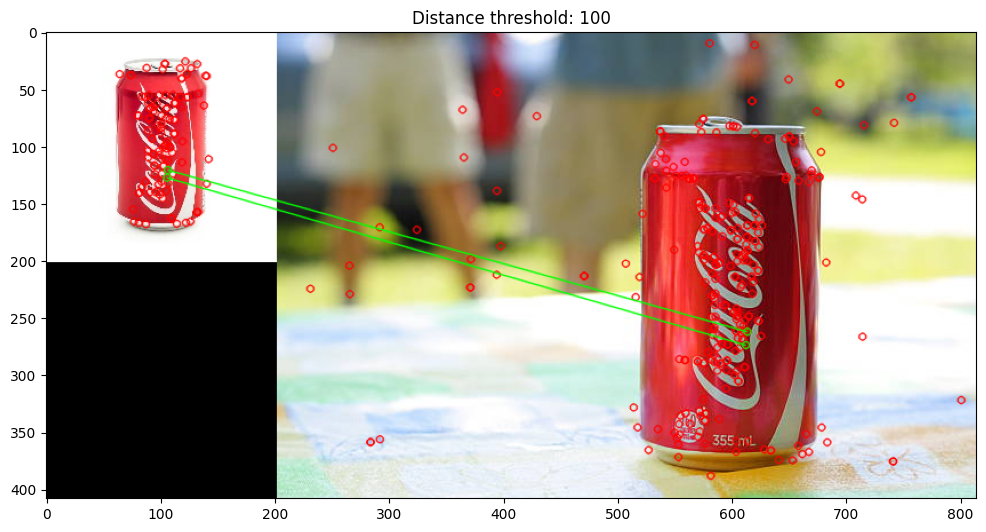

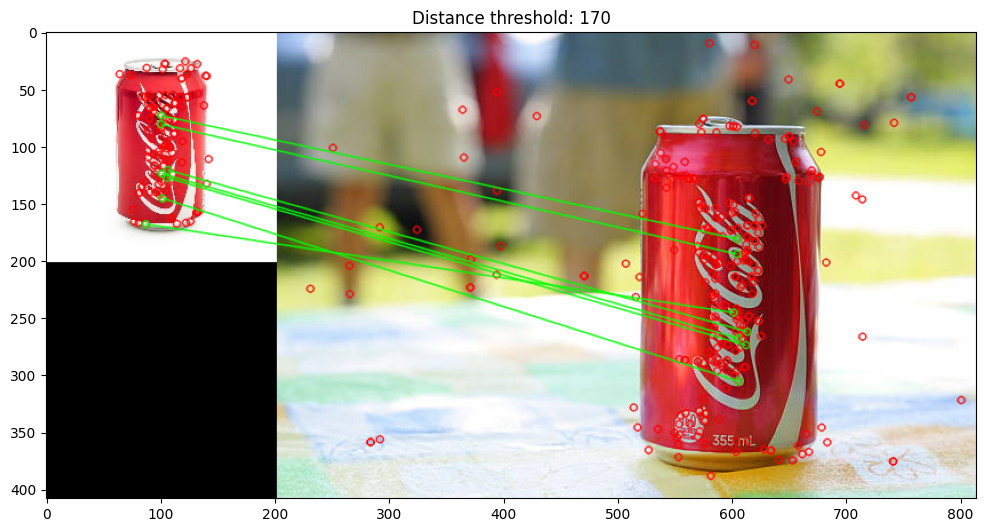

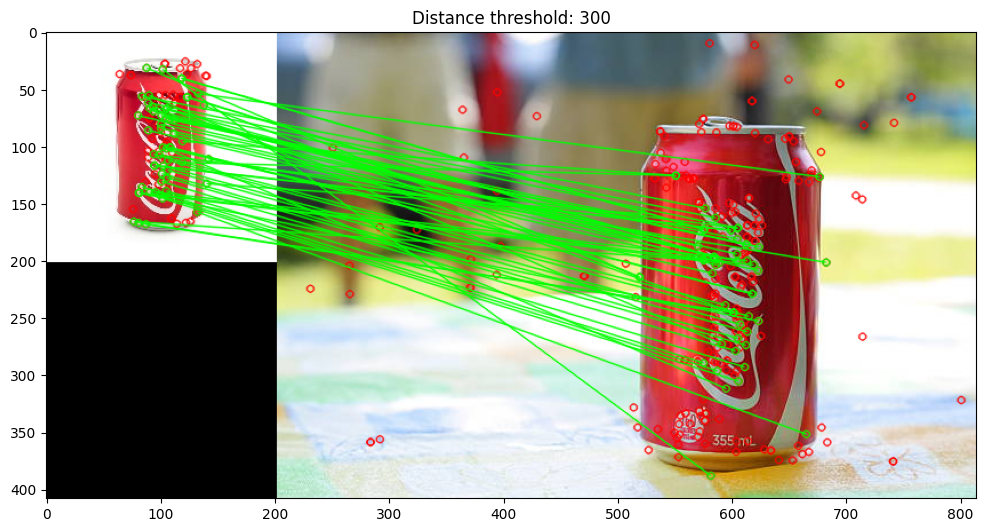

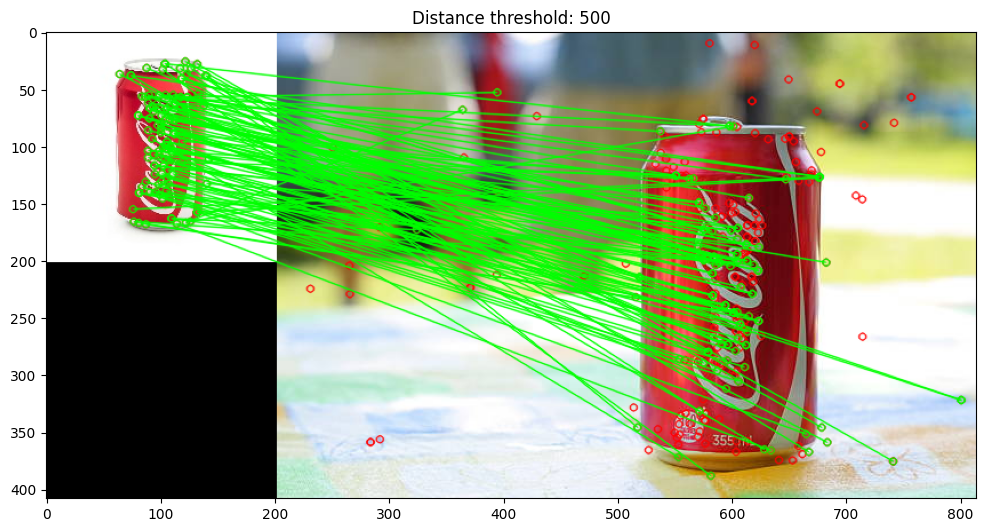

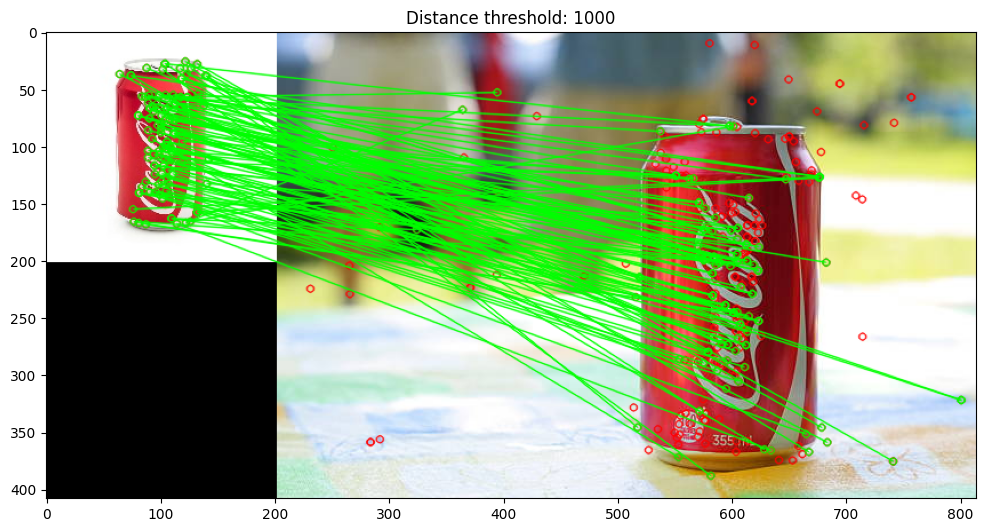

In [18]:
#  the higher the distance threshold, the more matches are found, but also more false positives are found

play_with_distance_threshold(0)
play_with_distance_threshold(100)
play_with_distance_threshold(170)
play_with_distance_threshold(300)
play_with_distance_threshold(500)
play_with_distance_threshold(1000)

##### Zadanie 3b

Znajdź transformację geometryczną dla par dopasowanych punktów, tak aby przekształcić `coke` (_train_) do geometrii `table` (_query_). Zademonstruj poprawność, zestawiając obok siebie przekształconą wersję `coke` oraz oryginalny `table`, bądź nanosząc jedno na drugie. Zidentyfikuj punkty, które znaleziona transformacja przekształca "dobrze", tzn. ich współrzędne po przekształceniu leżą w pobliżu odpowiadających im punktów z drugiego obrazu; nanieś je na obraz.

*Jak na wyniki wpływa wykrycie większej lub mniejszej liczby punktów kluczowych na etapie SIFT? W jakim stopniu filtracja poprawia rezultaty? Jak działa i jaką rolę w procesie parowania odgrywa RANSAC?*

In [19]:
# points on the image are all matched points between images
# green points are the ones that are accepted by RANSAC
# magenta points are the ones that are rejected by RANSAC


@interact(
    distance_threshold=IntSlider(min=0, max=500, step=1, value=200),
    contrast_threshold=FloatSlider(min=0, max=0.3, step=0.01, value=0.04),
)
def play_with_homography(distance_threshold, contrast_threshold):
    table_copy = table.copy()
    best_matches, kp1, ds1, kp2, ds2 = get_matches(contrastThreshold=contrast_threshold)
    if (best_matches is None) or (len(best_matches) < 4):
        print("Not enough matches to find a homography")
        return

    good_matches = [m for m in best_matches if m.distance < distance_threshold]
    src_pts = np.float32([kp1[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    dst_pts = np.float32([kp2[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)

    if len(src_pts) < 4 or len(dst_pts) < 4:
        print("Not enough matches to find a homography")
        return

    M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC)
    mask = mask.flatten().astype(bool)

    if M is None:
        print("Tried to find homography, but failed")
        return

    src_pts_transformed = (
        cv2.perspectiveTransform(src_pts[mask], M).squeeze().astype(np.int32)
    )
    neg_src_pts_transformed = (
        (cv2.perspectiveTransform(src_pts[~mask], M).squeeze().astype(np.int32))
        if np.any(~mask)
        else np.array([])
    )

    warped = cv2.warpPerspective(coke, M, (table.shape[1], table.shape[0]))

    dst_pts_pos = dst_pts[mask].squeeze().astype(np.int32)
    dst_pts_neg = dst_pts[~mask].squeeze().astype(np.int32)

    for pt in src_pts_transformed:
        cv2.circle(warped, tuple(pt), 5, (0, 255, 0), -1)

    for pt in neg_src_pts_transformed:
        cv2.circle(warped, tuple(pt), 5, (255, 0, 255), -1)

    for pt in dst_pts_pos:
        cv2.circle(table_copy, tuple(pt), 5, (0, 255, 0), -1)

    for pt in dst_pts_neg:
        cv2.circle(table_copy, tuple(pt), 5, (255, 0, 255), -1)

    f, (a1, a2) = plt.subplots(1, 2, figsize=(12, 12))
    a1.imshow(warped[..., ::-1])
    a2.imshow(table_copy[..., ::-1])
    a1.set_title(
        "Distance threshold: {}, contrast threshold: {}".format(
            distance_threshold, contrast_threshold
        )
    )

    fig, ax = plt.subplots()

    ax.imshow(table_copy[:, :, ::-1])
    ax.imshow(warped[:, :, ::-1], alpha=0.5)

    # Set the axis limits
    ax.set_xlim(0, table.shape[1])
    ax.set_ylim(table.shape[0], 0)
    ax.axis("off")

interactive(children=(IntSlider(value=200, description='distance_threshold', max=500), FloatSlider(value=0.04,…

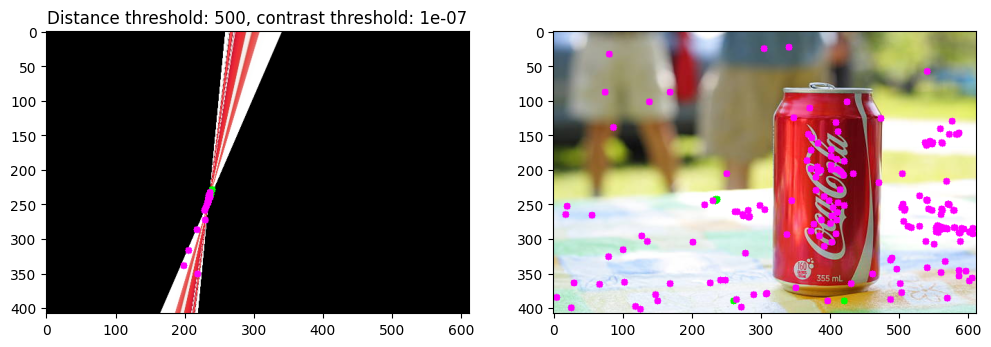

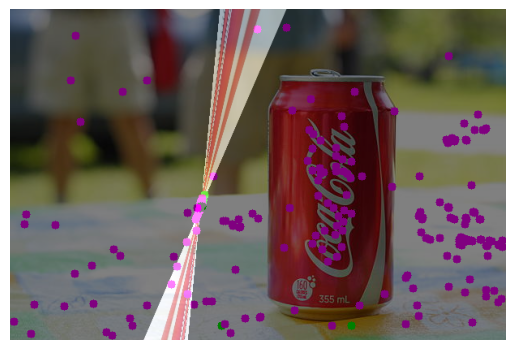

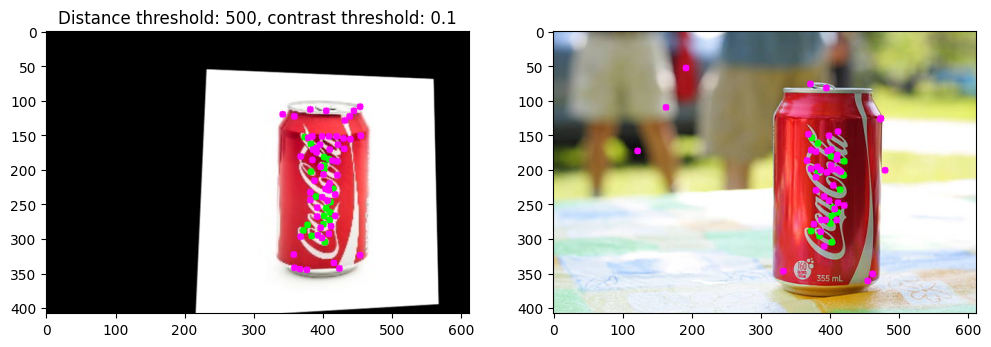

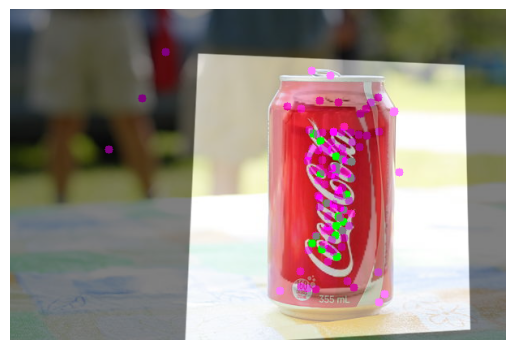

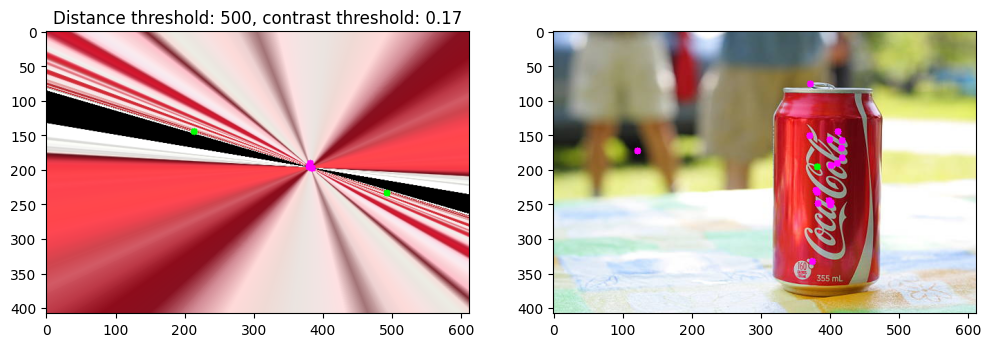

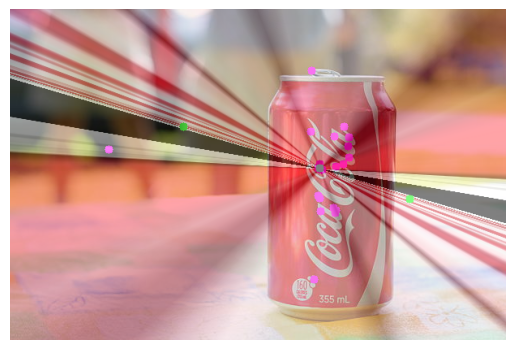

In [20]:
# if distance threshold is large, then contrast threshold needs to be balanced
# - too small means risk of not enough points to find a sensible homography
#   (it gives both many points in SIFT and many matches, but not enough good ones)
# - too large means risk of including outliers in RANSAC
#   (they may be considered inliers because there aren't enough points for RANSAC in the first place)
#   OR not enough points to find a sensible homography

play_with_homography(500, 0.0000001)
play_with_homography(500, 0.1)
play_with_homography(500, 0.17)

Not enough matches to find a homography


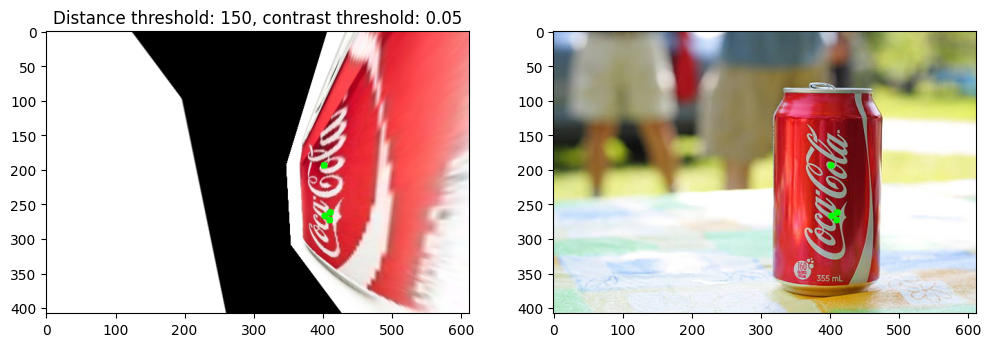

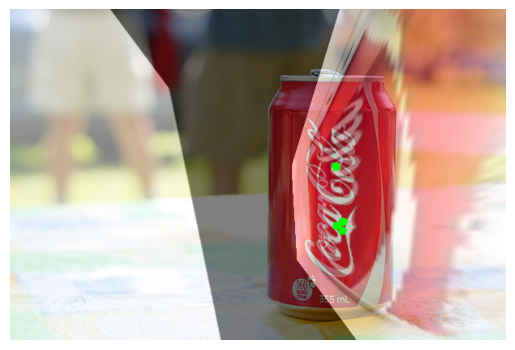

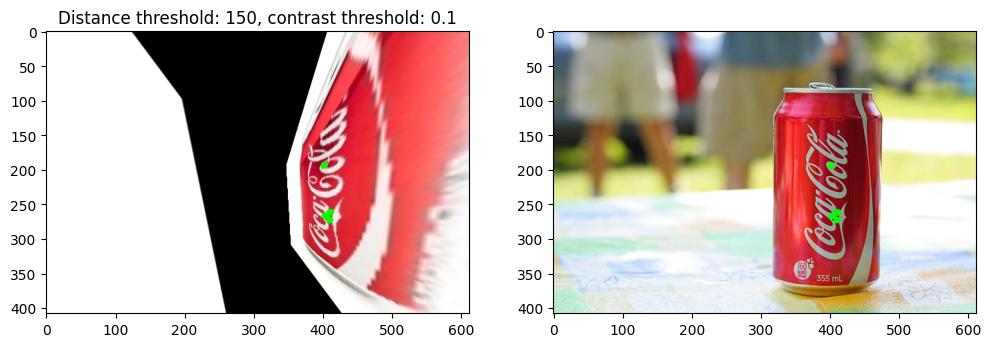

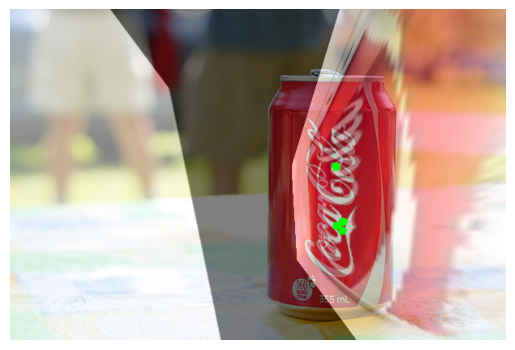

In [21]:
# if distance threshold is small, then we cannot make homography at all, or it is useless
# (small distance threshold means we remove almost all matching points and RANSAC has not enough points to work with)

play_with_homography(150, 0.05)
play_with_homography(150, 0.1)
play_with_homography(150, 0.15)

# NN match test

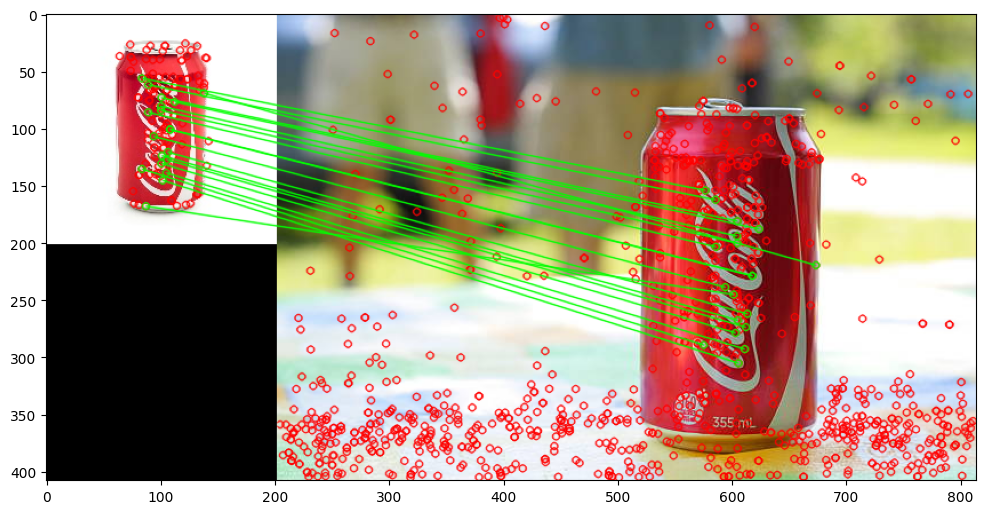

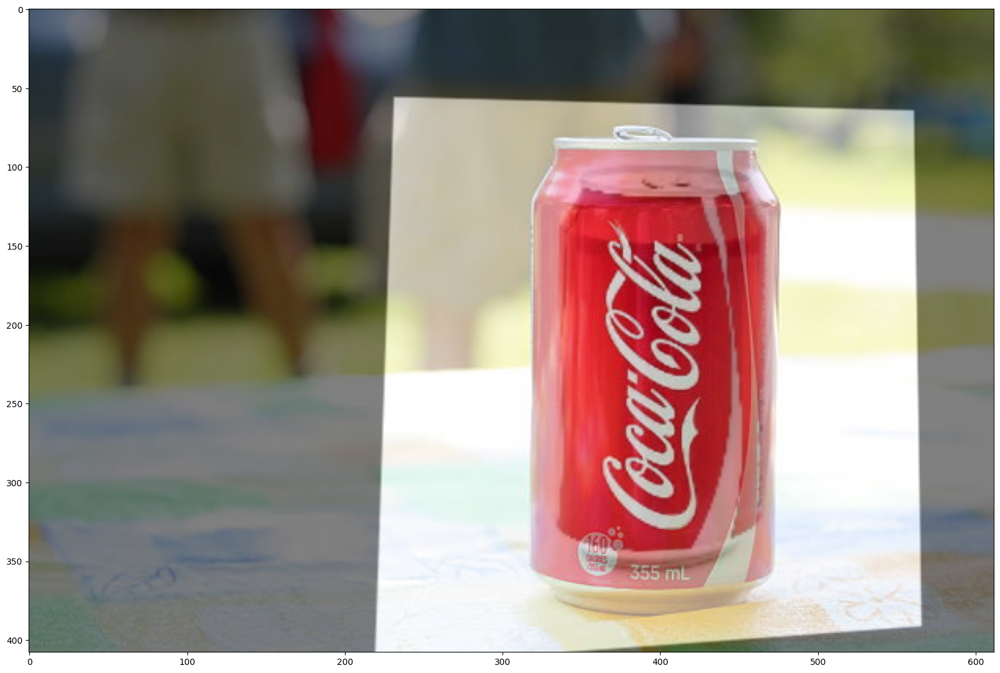

In [65]:
# NN match takes only very good matches, e.g. the Coca-Cola letters

sift = cv2.SIFT_create(contrastThreshold=0.01, edgeThreshold=10)

keypoints1, descriptors1 = sift.detectAndCompute(coke, mask=None)
keypoints2, descriptors2 = sift.detectAndCompute(table, mask=None)
bf = cv2.BFMatcher(cv2.NORM_L2)

matches = bf.knnMatch(descriptors1, descriptors2, k=2)

# Lowe's ratio test
good_matches = []
for m in matches:
    # Lowe's ratio test removes ambiguous matches, that is the ones that are indisinguishable
    # from the second best match, hence checking if ratio is small enough
    if m[0].distance < 0.7 * m[1].distance:
        good_matches.append(m)
matches = np.asarray(good_matches)

show_matches = cv2.drawMatches(
    coke,
    keypoints1,
    table,
    keypoints2,
    matches[:, 0],
    None,
    matchColor=(0, 255, 0),
    singlePointColor=(0, 0, 255),
)
plt.subplots(1, 1, figsize=(12, 12))[1].imshow(show_matches[..., ::-1])

src = np.float32([keypoints1[m.queryIdx].pt for m in matches[:, 0]]).reshape(-1, 1, 2)
dst = np.float32([keypoints2[m.trainIdx].pt for m in matches[:, 0]]).reshape(-1, 1, 2)

H, masked = cv2.findHomography(src, dst, cv2.RANSAC, 5.0)

dst = cv2.warpPerspective(
    coke,
    H,
    (table.shape[1], table.shape[0]),
)
fig, ax = plt.subplots(1, 1, figsize=(20, 15))
ax.imshow(table[:, :, ::-1])
ax.imshow(dst[:, :, ::-1], alpha=0.5)